In [1]:
import cv2
import os
import matplotlib.pyplot as plt
import math
import numpy as np

from glob import glob

from src.image_processor import ImageProcessor

# Roteiro I

In [2]:
train_directory = 'data/bracs-binary/train'
test_directory = 'data/bracs-binary/test'

train_processor = ImageProcessor(train_directory)
test_processor = ImageProcessor(test_directory)

processors = []
processors.append(train_processor)
processors.append(test_processor)

for processor in processors:
    processor.load_images()

Aplique a equalização de histograma nas imagens do dataset original (treino e teste). Em seguida, salve os resultados dos novos datasets;

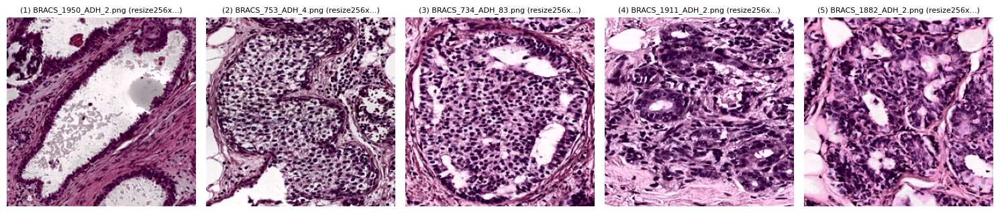

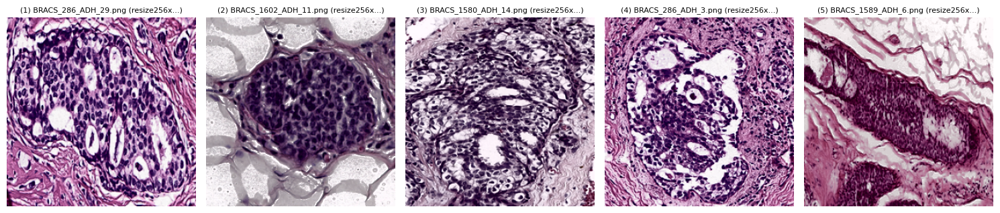

In [3]:
for processor in processors:
    processor.resize_images()
    processor.equalize_histogram()
    processor.show_sample_images(num_images=5)
    processor.save_images()
    processor.reset_images()

Aplique correção gamma nas imagens do dataset original (treino e teste), utilizando três diferentes valores de gamma (ajuste os parâmetros a seu critério). Em seguida, salve os resultados dos novos datasets;

In [4]:
gamma_values = [0.5, 1.5, 2.0]

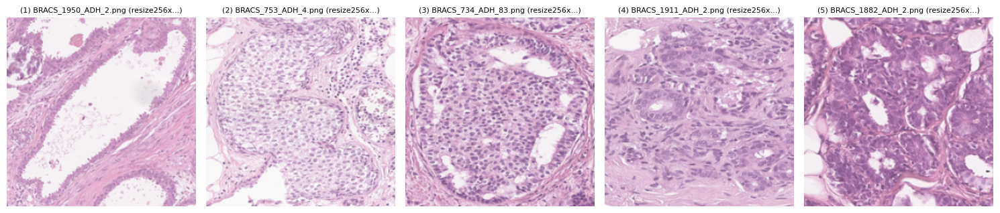

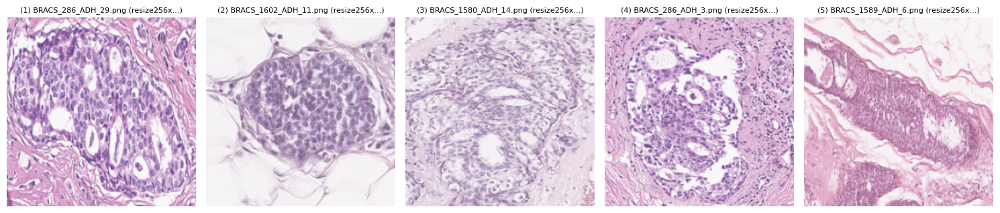

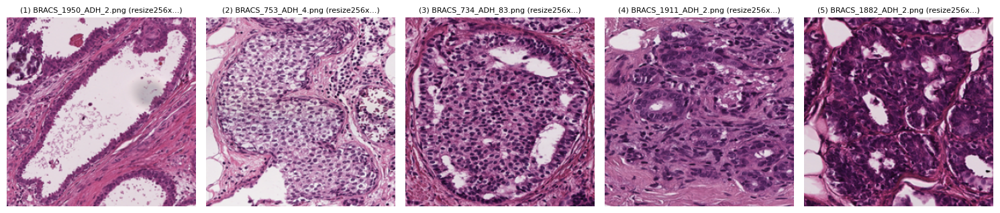

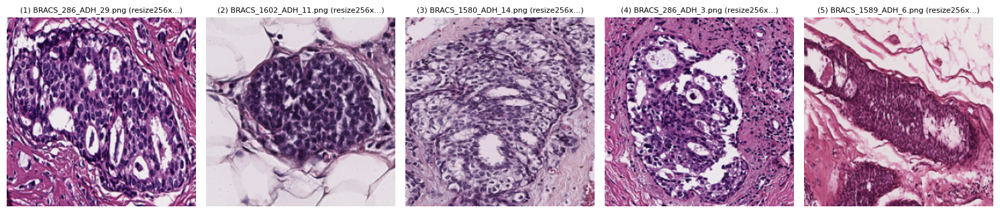

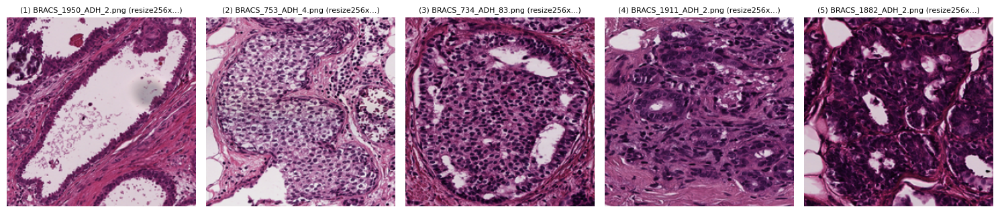

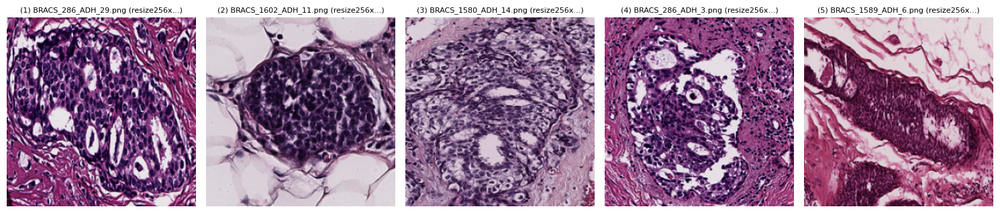

In [5]:
for gamma in gamma_values:
    for processor in processors:
        processor.resize_images()
        processor.gamma_correction(gamma)
        print(gamma)
        processor.show_sample_images(num_images=5)
        processor.save_images()
        processor.reset_images()

Suavize as imagens do dataset original(treino e teste) aplicando o filtro gaussiano (ajuste os parâmetros a seu critério). Em seguida, salve os resultados do novo dataset;

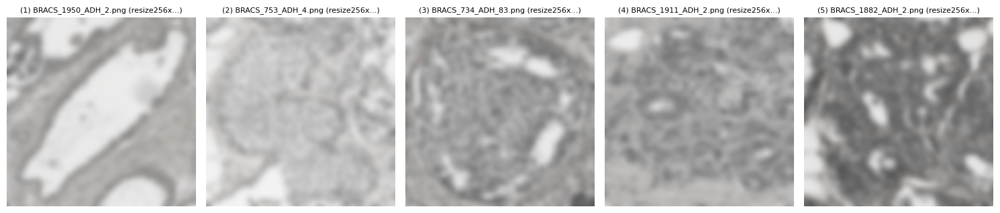

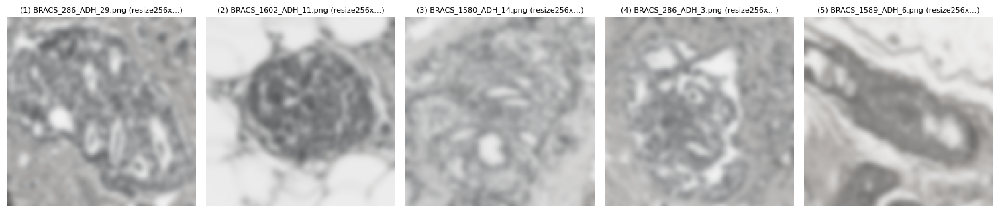

In [6]:
for processor in processors:
    processor.resize_images()
    processor.gaussian_smoothing(4)
    processor.show_sample_images(num_images=5)
    processor.save_images()
    processor.reset_images()

Realize o aguçamento das imagens do dataset original (treino e teste) aplicando o filtro laplace (ajuste os parâmetros a seu critério). Em seguida, salve os resultados do novo dataset.

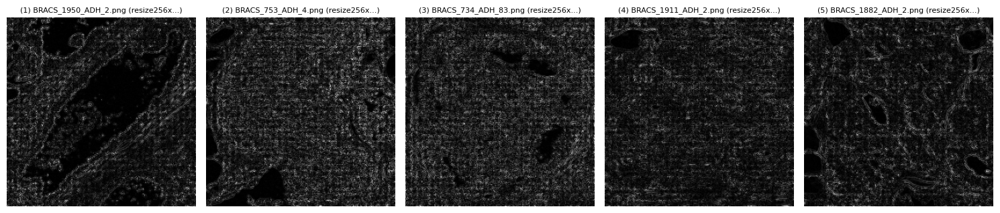

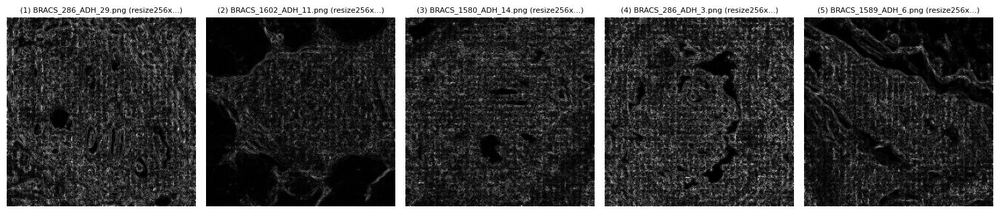

In [7]:
for processor in processors:
    processor.resize_images()
    processor.laplacian_sharpening() 
    processor.show_sample_images(num_images=5)
    processor.save_images()
    processor.reset_images()

# Roteiro II

Implemente as transformações de cor do cabeçalho da Figura 2.5, utilizando 3 imagens do dataset original 1 . Além disso, realize a extração das seguintes features:

(a) Histograma RGB

(b) O1 , O2

(c) Transformada de Cor

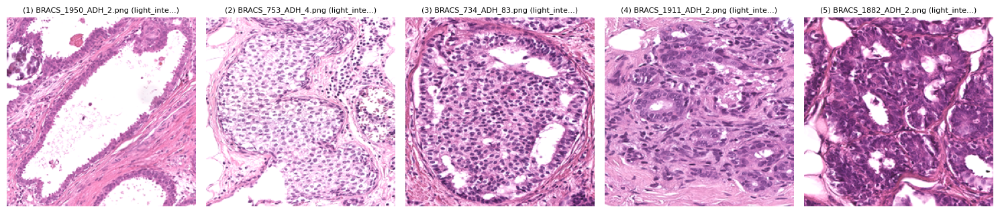

In [8]:
train_processor.light_intensity_change(a=1.2) 
train_processor.show_sample_images(num_images=5)
train_processor.save_images()
processor.reset_images()

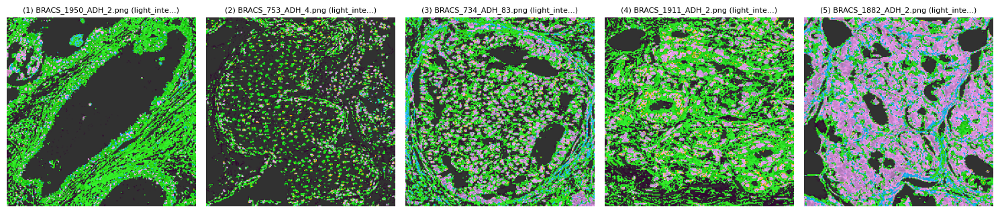

In [10]:
train_processor.light_intensity_shift(o1=50) 
train_processor.show_sample_images(num_images=5)
train_processor.save_images()
train_processor.reset_images()

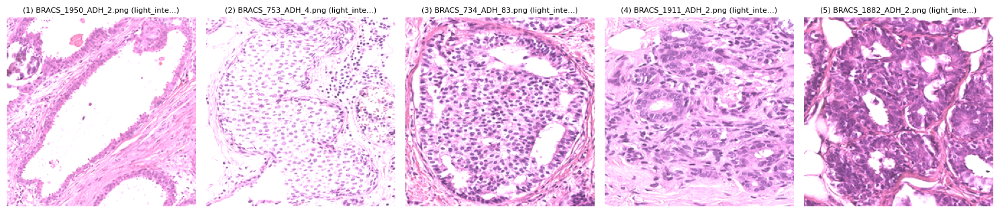

In [9]:
train_processor.light_intensity_change_and_shift(a=1.1, o1=30) 
train_processor.show_sample_images(num_images=5)
train_processor.save_images()

Além disso, realize a extração das seguintes features:

In [ ]:
rgb_histogram_features = processor.extract_rgb_histogram()
o1_o2_features = processor.extract_o1_o2()
color_transform_features = processor.extract_color_transform()

# Montando Figuras:

In [2]:
def plot_images(imagens):
    num_imagens = len(imagens)
    num_cols = 3
    num_rows = math.ceil(num_imagens / num_cols)  

    fig, axes = plt.subplots(num_rows, num_cols, figsize=(12, 4 * num_rows))  

    for i, (image_name, image_array) in enumerate(imagens.items()):
        row, col = divmod(i, num_cols)
        axes[row, col].imshow(image_array)  
        title = f"({i+1}) {image_name}"
        if len(title) > 40:
            title = title[:40] + '...'
        axes[row, col].set_title(title)  
        axes[row, col].axis('off')  

    for j in range(i + 1, num_rows * num_cols):
        row, col = divmod(j, num_cols)
        axes[row, col].axis('off')  

    plt.tight_layout()
    plt.show()

In [4]:
amostras = 'data/bracs-binary/amostras'
amostras_processor = ImageProcessor(amostras)
amostras_processor.load_images()
amostras = {}


In [5]:
amostras = amostras_processor.get_images()

amostras_processor.convert_to_grayscale()
amostras.update(amostras_processor.get_images())

amostras_processor.equalize_histogram()
amostras.update(amostras_processor.get_images())

amostras_processor.reset_images()

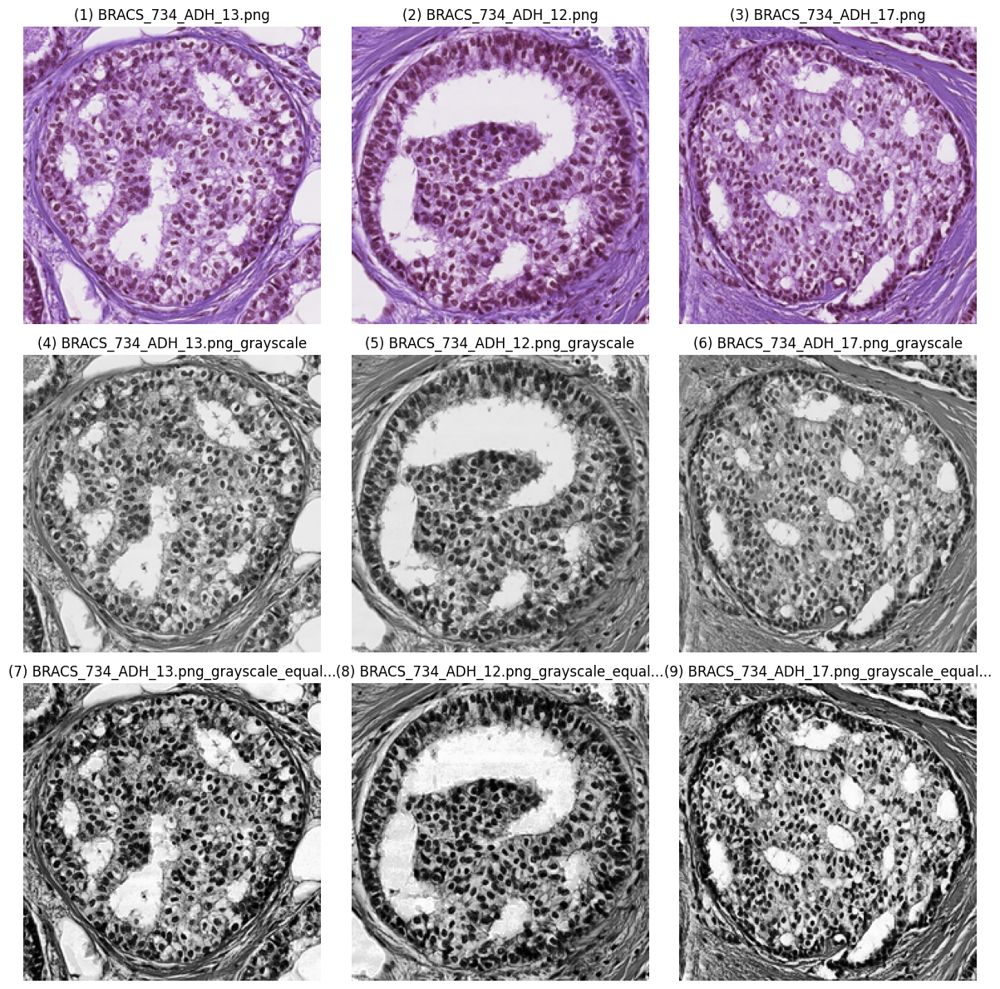

In [15]:
plot_images(amostras)

In [16]:
amostras = amostras_processor.get_images()

amostras_processor.convert_to_grayscale()
amostras.update(amostras_processor.get_images())

amostras_processor.laplacian_sharpening()
amostras.update(amostras_processor.get_images())

amostras_processor.reset_images()

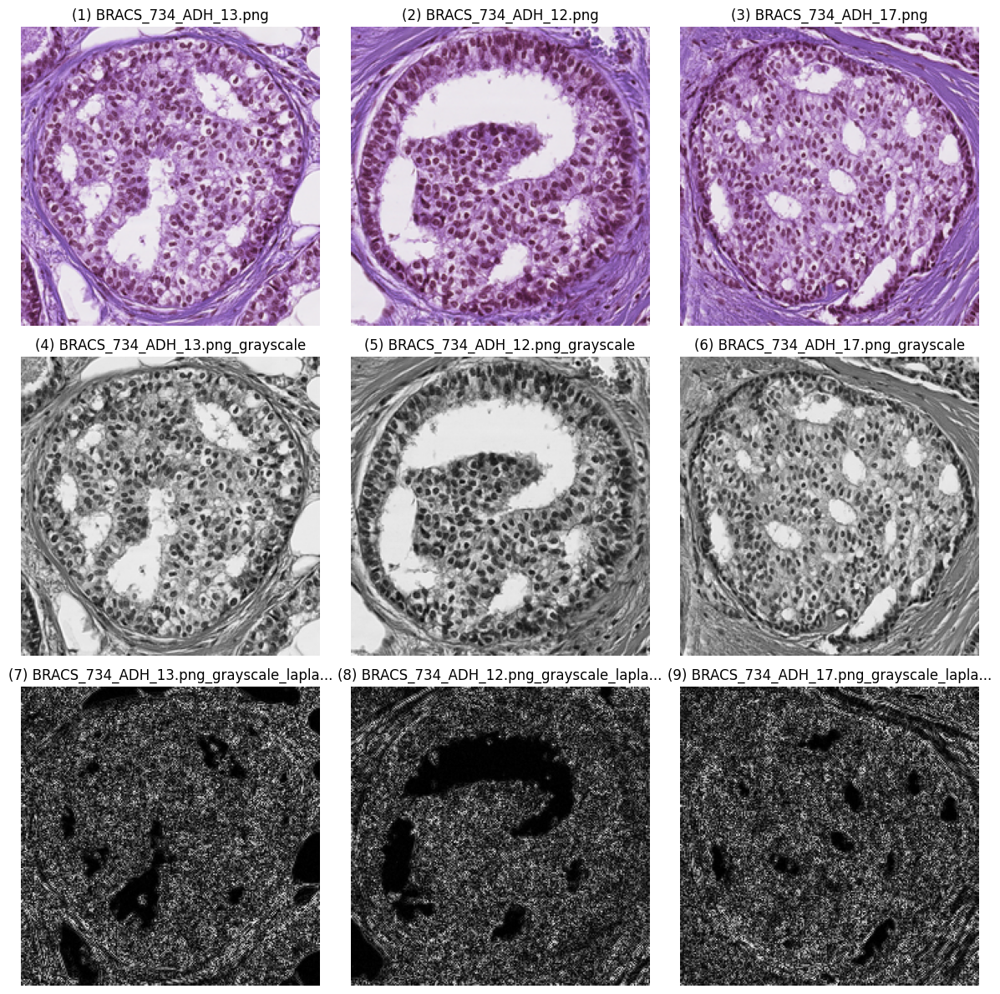

In [17]:
plot_images(amostras)

In [18]:
amostras = {}

amostras_processor.convert_to_grayscale()
amostras_processor.gaussian_smoothing(sigma=4)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

amostras_processor.convert_to_grayscale()
amostras_processor.gaussian_smoothing(sigma=16)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

amostras_processor.convert_to_grayscale()
amostras_processor.gaussian_smoothing(sigma=32)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

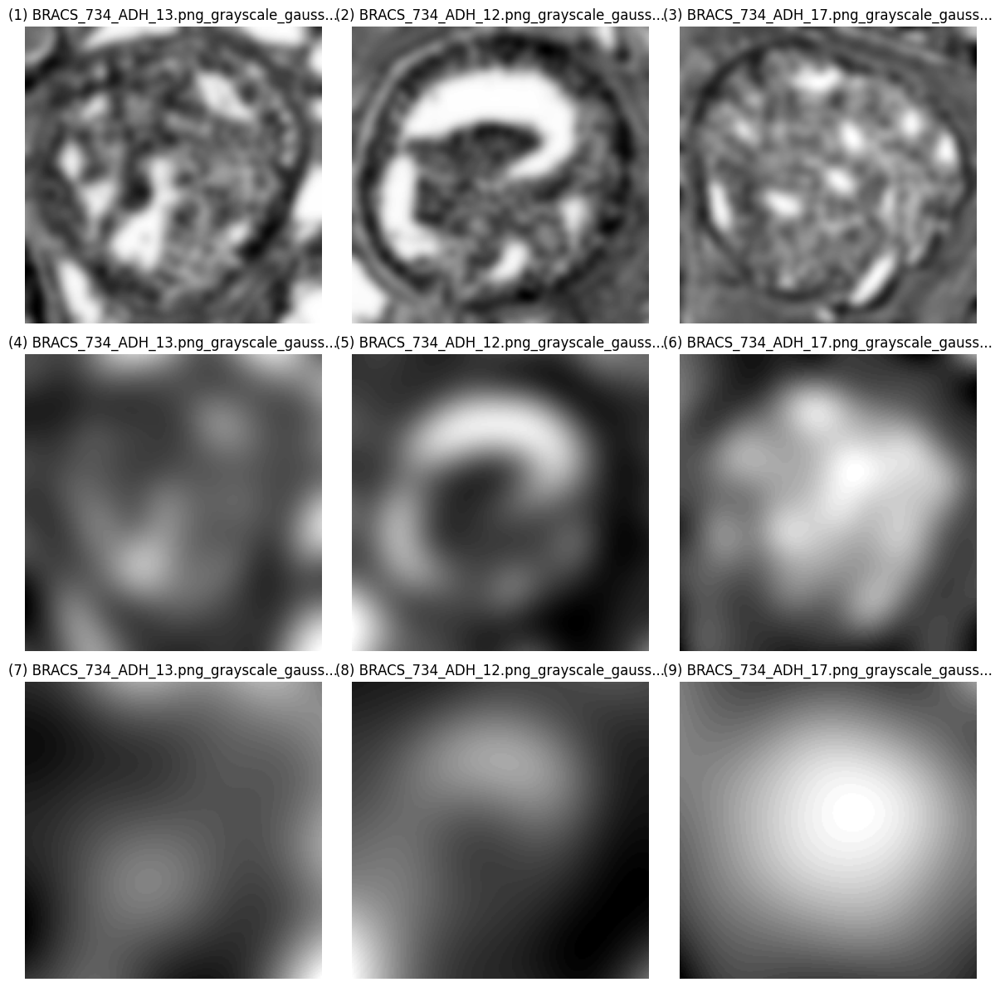

In [10]:
plot_images(amostras)

In [19]:
amostras = {}

amostras_processor.convert_to_grayscale()
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

amostras_processor.convert_to_grayscale()
amostras_processor.gamma_correction(0.5)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

amostras_processor.convert_to_grayscale()
amostras_processor.gamma_correction(1.5)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

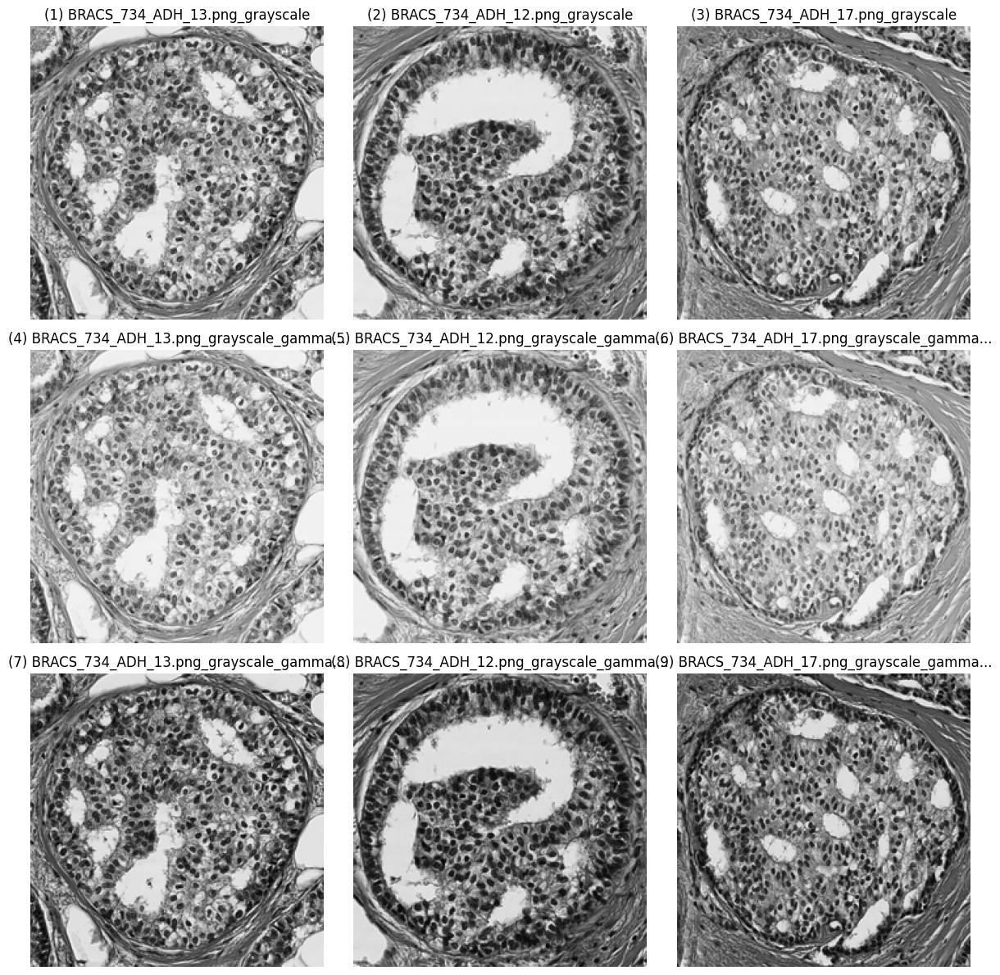

In [20]:
plot_images(amostras)

In [6]:
amostras = {}

amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

amostras_processor.light_intensity_shift(30)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

amostras_processor.light_intensity_change(1.2)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

amostras_processor.light_intensity_change_and_shift(1.2, 30)
amostras.update(amostras_processor.get_images())
amostras_processor.reset_images()

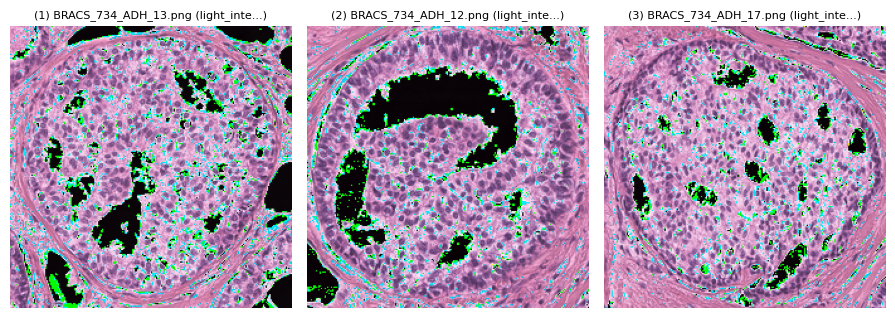

In [7]:
amostras_processor.light_intensity_shift(29)
amostras_processor.show_sample_images()
amostras_processor.reset_images()

In [12]:
amostras_processor.reset_images()
amostras_processor.light_intensity_shift(30)
amostras = amostras_processor.get_images()
amostras

def verifica_pixel_preto(imagem_dict):
    for nome_imagem, dados_imagem in imagem_dict.items():
        # Verifica se existe algum pixel (0, 0, 0)
        if np.any(np.all(dados_imagem == [0, 0, 0], axis=-1)):
            print(f"Pixel (0, 0, 0) encontrado na imagem: {nome_imagem}")
        else:
            print(f"Nenhum pixel (0, 0, 0) encontrado na imagem: {nome_imagem}")

verifica_pixel_preto(amostras)

Nenhum pixel (0, 0, 0) encontrado na imagem: BRACS_734_ADH_13.png_light_intensity_shift_o1_30
Nenhum pixel (0, 0, 0) encontrado na imagem: BRACS_734_ADH_12.png_light_intensity_shift_o1_30
Nenhum pixel (0, 0, 0) encontrado na imagem: BRACS_734_ADH_17.png_light_intensity_shift_o1_30


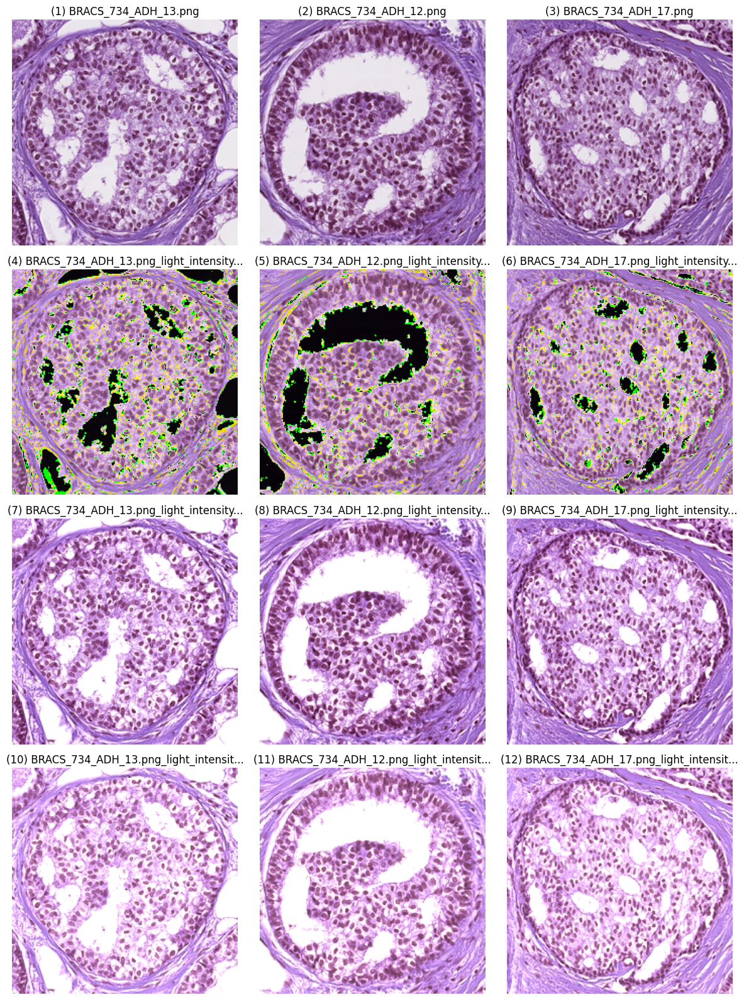

In [23]:
plot_images(amostras)